In [1]:
# MSVD Video Captioning Pipeline (Starter Code)
# Phase 1: Load Annotations and Preprocess Captions

import pandas as pd
import os
import re
import numpy as np
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import pickle

# Load English annotations
ANNOTATION_PATH = "/kaggle/input/msvd-dataset-corpus/annotations.txt"
annotations = {}
with open(ANNOTATION_PATH, "r") as file:
    for line in file:
        video_id, caption = line.strip().split(' ', 1)
        annotations.setdefault(video_id, []).append(caption.lower())

print(f"Loaded captions for {len(annotations)} video segments")

# Add special tokens and clean captions
def preprocess_caption(caption):
    caption = re.sub(r"[^a-zA-Z0-9 ]", "", caption)
    return f"startseq {caption.strip()} endseq"

# Apply preprocessing
dataset = []
for video_id, caps in annotations.items():
    for c in caps:
        dataset.append((video_id, preprocess_caption(c)))

print(f"Total caption pairs: {len(dataset)}")

# Create tokenizer
all_captions = [cap for _, cap in dataset]
tokenizer = Tokenizer(oov_token='<unk>')
tokenizer.fit_on_texts(all_captions)

#If tokenizer is done
# TOKENIZER_PATH = "/kaggle/working/tokenizer.pkl"
# with open(TOKENIZER_PATH, "rb") as f:
#     tokenizer = pickle.load(f)
# print("Loaded existing tokenizer.")

#If tokenizer is to be newly generated
TOKENIZER_PATH = "/kaggle/working/tokenizer.pkl"
tokenizer = Tokenizer(oov_token='<unk>')
tokenizer.fit_on_texts(all_captions)
with open(TOKENIZER_PATH, "wb") as f:
    pickle.dump(tokenizer, f)
print("Created and saved new tokenizer.")
    
vocab_size = len(tokenizer.word_index) + 1
print(f"Vocabulary size: {vocab_size}")

# Create a dictionary of video_id -> processed captions
descriptions = {}
for vid, cap in dataset:
    descriptions.setdefault(vid, []).append(cap)

2025-06-15 17:49:45.792002: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750009785.998581      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750009786.055486      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Loaded captions for 1970 video segments
Total caption pairs: 80827
Created and saved new tokenizer.
Vocabulary size: 12596


In [2]:
# Phase 2: Frame Extraction + CNN Feature Extraction
import cv2
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.utils import img_to_array

# Load InceptionV3 model without top layer
base_model = InceptionV3(weights='imagenet')
cnn_model = Model(base_model.input, base_model.layers[-2].output)

VIDEO_DIR = "/kaggle/input/msvd-clips/YouTubeClips"

# Function to extract frames from a video
def extract_frames(video_path, num_frames=20):
    cap = cv2.VideoCapture(video_path)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    frame_ids = np.linspace(0, total_frames - 1, num_frames, dtype=int)
    frames = []

    for fid in frame_ids:
        cap.set(cv2.CAP_PROP_POS_FRAMES, fid)
        success, frame = cap.read()
        if success:
            frame = cv2.resize(frame, (299, 299))
            frame = img_to_array(frame)
            frame = preprocess_input(frame)
            frames.append(frame)
    cap.release()
    return np.array(frames)

# Function to extract features for a video
def extract_video_features(video_id):
    video_path = os.path.join(VIDEO_DIR, video_id + ".avi")
    if not os.path.exists(video_path):
        return None
    frames = extract_frames(video_path)
    if len(frames) == 0:
        return None
    features = cnn_model.predict(frames, verbose=0)
    return np.mean(features, axis=0)

#If feature extraction is already done
# FEATURES_PATH = "/kaggle/working/video_features.pkl"
# with open(FEATURES_PATH, "rb") as f:
#     video_features = pickle.load(f)
# print(f"Loaded existing video features from {FEATURES_PATH}")

# If feature extraction is to be newly executed
# Example: Extract and save features for first n videos
FEATURES_PATH = "/kaggle/working/video_features.pkl"
video_features = {}
for i, video_id in enumerate(list(descriptions.keys())[:200]):
    feats = extract_video_features(video_id)
    if feats is not None:
        video_features[video_id] = feats
    print(f"[{i+1}/200] Processed: {video_id}")

# Save extracted features
with open(FEATURES_PATH, "wb") as f:
    pickle.dump(video_features, f)

print("Saved video features for msvd videos.")

I0000 00:00:1750009813.058691      35 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1750009813.059443      35 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


96112376/96112376 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


I0000 00:00:1750009820.333912      81 service.cc:148] XLA service 0x78e4dc157910 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1750009820.334802      81 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1750009820.334822      81 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1750009821.280610      81 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1750009828.758867      81 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


[1/200] Processed: -4wsuPCjDBc_5_15
[2/200] Processed: -7KMZQEsJW4_205_208
[3/200] Processed: -8y1Q0rA3n8_108_115
[4/200] Processed: -8y1Q0rA3n8_95_102
[5/200] Processed: -9CUm-2cui8_39_44
[6/200] Processed: -AwoiGR6c8M_10_14
[7/200] Processed: -Cv5LsqKUXc_17_25
[8/200] Processed: -Cv5LsqKUXc_71_76
[9/200] Processed: -DKuLXYoY3g_14_20
[10/200] Processed: -DRy7rBg0IQ_31_37
[11/200] Processed: -FugkxLmGO4_5_16
[12/200] Processed: -Ms9tsWmhyU_80_95
[13/200] Processed: -YI0cxuNcq8_262_272
[14/200] Processed: -_aaMGK6GGw_57_61
[15/200] Processed: -_hbPLsZvvo_172_179
[16/200] Processed: -_hbPLsZvvo_18_25
[17/200] Processed: -_hbPLsZvvo_19_25
[18/200] Processed: -_hbPLsZvvo_19_26
[19/200] Processed: -_hbPLsZvvo_211_219
[20/200] Processed: -_hbPLsZvvo_269_275
[21/200] Processed: -_hbPLsZvvo_288_305
[22/200] Processed: -_hbPLsZvvo_323_328
[23/200] Processed: -_hbPLsZvvo_43_55
[24/200] Processed: -_hbPLsZvvo_49_55
[25/200] Processed: -_hbPLsZvvo_5_8
[26/200] Processed: -bjOB4zS0uE_100_105
[27/20

In [3]:
# Phase 3: Caption Generation Model
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, LSTM, Embedding, Dropout, add

# Parameters
max_length = max(len(c.split()) for c in all_captions)
embedding_dim = 256

# Define the captioning model
def define_model(vocab_size, max_length):
    # Feature extractor (from video)
    inputs1 = Input(shape=(2048,))
    fe1 = Dropout(0.5)(inputs1)
    fe2 = Dense(embedding_dim, activation='relu')(fe1)

    # Sequence processor (captions)
    inputs2 = Input(shape=(max_length,))
    se1 = Embedding(vocab_size, embedding_dim, mask_zero=True)(inputs2)
    se2 = Dropout(0.5)(se1)
    # se3 = LSTM(256)(se2)
    se3 = LSTM(256, return_sequences=False, recurrent_activation='sigmoid')(se2)
    # Decoder (combine both)
    decoder1 = add([fe2, se3])
    decoder2 = Dense(256, activation='relu')(decoder1)
    outputs = Dense(vocab_size, activation='softmax')(decoder2)

    model = Model(inputs=[inputs1, inputs2], outputs=outputs)
    model.compile(loss='categorical_crossentropy', optimizer='adam')
    return model

# Create the model
model = define_model(vocab_size, max_length)
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 47)             │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ input_layer_1             │ (None, 2048)           │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ embedding (Embedding)     │ (None, 47, 256)        │      3,224,576 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout (Dropout)         │ (None, 2048)           │              0 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_1 (Dropout)       │ (None, 47, 256)        │              0 │ embedding[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ not_equal (NotEqual)      │ (None, 47)             │              0 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 256)            │        524,544 │ dropout[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm (LSTM)               │ (None, 256)            │        525,312 │ dropout_1[0][0],       │
│                           │                        │                │ not_equal[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add (Add)                 │ (None, 256)            │              0 │ dense[0][0],           │
│                           │                        │                │ lstm[0][0]             │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 256)            │         65,792 │ add[0][0]              │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_2 (Dense)           │ (None, 12596)          │      3,237,172 │ dense_1[0][0]          │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 7,577,396 (28.91 MB)

 Trainable params: 7,577,396 (28.91 MB)

 Non-trainable params: 0 (0.00 B)

In [4]:
# Code for videoplay and video conversion to mp4
!pip install ffmpeg-python
import ffmpeg
from IPython.display import HTML
from base64 import b64encode
# Function to embed and play a video in a Jupyter Notebook
def play(filename):
    html = ''
    video = open(filename, 'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=300 height=200 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src 
    return HTML(html)

# Function to convert any input video file to MP4 format using FFmpeg
def convert_to_mp4(input_path, output_path):
    try:
        ffmpeg.input(input_path).output(output_path).run(quiet=True, overwrite_output=True)
        return True
    except ffmpeg.Error as e:
        print(f"Error converting file: {e}")
        return False

In [5]:
# Phase 4: Training + Caption Generation + Evaluation 

import numpy as np
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from nltk.translate.bleu_score import corpus_bleu

# Step 1: Create training sequences (with right-padding fix)
def create_sequences(tokenizer, max_length, descriptions, video_features, vocab_size):
    X1, X2, y = [], [], []
    for video_id, caps in descriptions.items():
        feature = video_features.get(video_id)
        if feature is None:
            continue
        for cap in caps:
            seq = tokenizer.texts_to_sequences([cap])[0]
            for i in range(1, len(seq)):
                in_seq, out_seq = seq[:i], seq[i]
                # ✅ Fix: ensure right-padding for cuDNN compatibility
                in_seq = pad_sequences([in_seq], maxlen=max_length, padding='post')[0]
                out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                X1.append(feature)
                X2.append(in_seq)
                y.append(out_seq)
    return np.array(X1), np.array(X2), np.array(y)

# Prepare sequences
X1train, X2train, ytrain = create_sequences(tokenizer, max_length, descriptions, video_features, vocab_size)
print(f"Training data shapes -> Video: {X1train.shape}, Captions: {X2train.shape}, Labels: {ytrain.shape}")

# Step 2: Train the model
history = model.fit([X1train, X2train], ytrain, epochs=50, batch_size=64, verbose=1)

# Save the trained model
# model.save("video_caption_model.h5")

# model.export("video_caption_model")

# print("Model saved!")


# Step 3: Generate caption (inference, fixed version)
def generate_caption(model, tokenizer, video_feat, max_length):
    in_text = 'startseq'
    for _ in range(max_length):
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        # ✅ Fix: pad with right-padding (post), for cuDNN compliance
        sequence = pad_sequences([sequence], maxlen=max_length, padding='post')
        yhat = model.predict([np.array([video_feat]), sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = tokenizer.index_word.get(yhat)
        if word is None:
            break
        in_text += ' ' + word
        if word == 'endseq':
            break
    return in_text.replace('startseq', '').replace('endseq', '').strip()

# Example caption generation
test_video_id = list(video_features.keys())[0]
test_feat = video_features[test_video_id]
caption = generate_caption(model, tokenizer, test_feat, max_length)
print(f"Generated Caption for video {test_video_id}:\n{caption}")
input_path = "/kaggle/input/msvd-clips/YouTubeClips/-4wsuPCjDBc_5_15.avi"
output_path = "/kaggle/working/temp_video.mp4"

# Convert AVI to MP4
if convert_to_mp4(input_path, output_path):
    # Display the MP4 video
    display(play(output_path))
else:
    print("Failed to convert video.")

# Step 4: BLEU score evaluation (safe against future key errors)
actual, predicted = [], []
for vid_id in list(descriptions.keys())[:200]:  # Evaluate on 200 samples
    y_pred = generate_caption(model, tokenizer, video_features[vid_id], max_length)
    references = [d.split() for d in descriptions[vid_id]]
    actual.append(references)
    predicted.append(y_pred.split())

# BLEU scores
print('BLEU-1: %f' % corpus_bleu(actual, predicted, weights=(1.0, 0, 0, 0)))
print('BLEU-2: %f' % corpus_bleu(actual, predicted, weights=(0.5, 0.5, 0, 0)))
print('BLEU-3: %f' % corpus_bleu(actual, predicted, weights=(0.3, 0.3, 0.3, 0)))
print('BLEU-4: %f' % corpus_bleu(actual, predicted, weights=(0.25, 0.25, 0.25, 0.25)))


Training data shapes -> Video: (62920, 2048), Captions: (62920, 47), Labels: (62920, 12596)
Epoch 1/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 14s 10ms/step - loss: 4.7258
Epoch 2/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 3.0491
Epoch 3/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 2.5333
Epoch 4/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 2.1684
Epoch 5/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 1.9214
Epoch 6/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 1.7449
Epoch 7/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 1.6023
Epoch 8/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 1.4769
Epoch 9/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 1.3946
Epoch 10/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 1.3220
Epoch 11/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 1.2337
Epoch 12/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 1.1830
Epoch 13/50
984/984 ━━━━━━━━━━━━━━━━━━━━ 10s 10ms/step - loss: 1.1168
Epoch 1

BLEU-1: 0.978291
BLEU-2: 0.972666
BLEU-3: 0.968100
BLEU-4: 0.958316


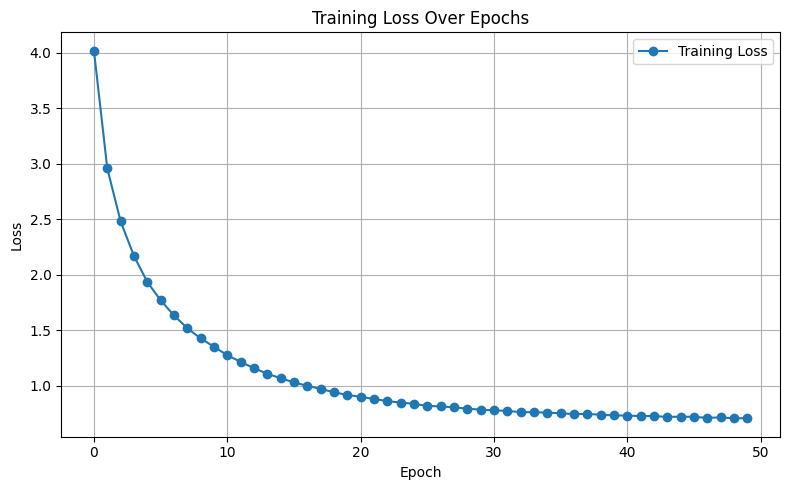

In [6]:
import matplotlib.pyplot as plt

# Plot training loss
plt.figure(figsize=(8, 5))
plt.plot(history.history['loss'], label='Training Loss', marker='o')
plt.title('Training Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


No model was supplied, defaulted to distilbert/distilbert-base-uncased-finetuned-sst-2-english and revision 714eb0f (https://huggingface.co/distilbert/distilbert-base-uncased-finetuned-sst-2-english).
Using a pipeline without specifying a model name and revision in production is not recommended.
Device set to use cuda:0
Some weights of the model checkpoint at microsoft/deberta-large-mnli were not used when initializing DebertaForSequenceClassification: ['config']
- This IS expected if you are initializing DebertaForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DebertaForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Device set to use cuda:0



[1/14] Now Playing: video13


Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


Caption: a woman is removing food from oil
Predicted Topic: food
------------------------------------------------------------

[2/14] Now Playing: video12


Caption: a woman is pouring scrambled eggs into a pan
Predicted Topic: food
------------------------------------------------------------

[3/14] Now Playing: video1


Caption: a woman is filtering some food powder
Predicted Topic: food
------------------------------------------------------------

[4/14] Now Playing: video8


Caption: a woman is filtering some food
Predicted Topic: food
------------------------------------------------------------

[5/14] Now Playing: video7


Caption: a woman is frying pork
Predicted Topic: animal
------------------------------------------------------------

[6/14] Now Playing: video4


Caption: a woman is preparing strawberry daifuku
Predicted Topic: food
------------------------------------------------------------

[7/14] Now Playing: video6


Caption: a baby is playing in the water
Predicted Topic: family
------------------------------------------------------------

[8/14] Now Playing: video11


Caption: a woman is adding ingredients to a bowl
Predicted Topic: food
------------------------------------------------------------

[9/14] Now Playing: video10


Caption: a woman is slicing a carrot
Predicted Topic: food
------------------------------------------------------------

[10/14] Now Playing: video9


Caption: a woman is slicing a carrot
Predicted Topic: food
------------------------------------------------------------

[11/14] Now Playing: video14


Caption: a man is chopping scallions
Predicted Topic: food
------------------------------------------------------------

[12/14] Now Playing: video3


Caption: a woman is forming and coating a rice patty
Predicted Topic: food
------------------------------------------------------------

[13/14] Now Playing: video5


Caption: a woman is slicing a carrot
Predicted Topic: food
------------------------------------------------------------

[14/14] Now Playing: video2


Caption: a woman is slicing cucumber
Predicted Topic: food
------------------------------------------------------------

Top 3 Topics in FOOD Dataset:
food: 12
animal: 1
family: 1

Evaluation Metrics (FOOD Dataset):
Accuracy : 0.86
Precision: 1.00
Recall   : 0.86
F1 Score : 0.92


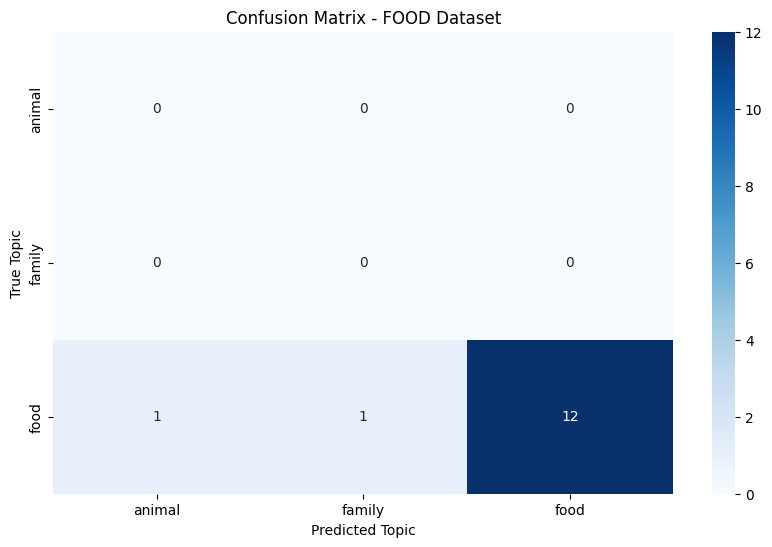

In [16]:
# === PHASE 5: FOOD DATASET ===
import os
import numpy as np
from collections import Counter
from transformers import pipeline
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
import seaborn as sns
import matplotlib.pyplot as plt

# Load transformers pipelines
sentiment_analyzer = pipeline('sentiment-analysis')
classifier = pipeline("zero-shot-classification", model="microsoft/deberta-large-mnli")

# Define topics
labels = [
    "education", "health", "travel", "politics", "finance", "technology", "sports", "music",
    "nature", "food", "animal", "vehicles", "shopping", "weather", "fitness", "art", "history",
    "science", "family", "transportation", "war", "crime", "disaster", "fashion", "space",
    "architecture", "religion", "military", "gaming", "internet", "meditation"
]

# Set directories
TEST_VIDEO_DIR = "/kaggle/input/testing-dataset/Food"
OUTPUT_VIDEO_DIR = "/kaggle/working/converted_videos"
os.makedirs(OUTPUT_VIDEO_DIR, exist_ok=True)

# Initialize
test_video_features = {}
test_captions = []
topics = []
sentiments = []
video_ids = []

test_video_files = [f for f in os.listdir(TEST_VIDEO_DIR) if f.endswith(('.mp4', '.avi'))]

# === Loop over Food videos ===
for i, file_name in enumerate(test_video_files):
    input_path = os.path.join(TEST_VIDEO_DIR, file_name)
    video_id = os.path.splitext(file_name)[0]
    video_ids.append(video_id)

    # Convert if AVI
    if file_name.endswith('.avi'):
        output_path = os.path.join(OUTPUT_VIDEO_DIR, video_id + ".mp4")
        success = convert_to_mp4(input_path, output_path)
        if not success:
            print(f"[{i+1}] Skipped (conversion failed): {file_name}")
            continue
        video_path = output_path
    else:
        video_path = input_path

    # Play video
    print(f"\n[{i+1}/{len(test_video_files)}] Now Playing: {video_id}")
    display(play(video_path))

    # Extract frames
    frames = extract_frames(video_path)
    if len(frames) == 0:
        print(f"[{i+1}] Skipped (no frames): {video_id}")
        continue

    # Extract features
    features = cnn_model.predict(frames, verbose=0)
    mean_feature = np.mean(features, axis=0)
    test_video_features[video_id] = mean_feature

    # Generate caption
    caption = generate_caption(model, tokenizer, mean_feature, max_length=20)
    test_captions.append((video_id, caption))

    # Sentiment
    sentiment_result = sentiment_analyzer(caption)[0]
    sentiments.append(sentiment_result['label'])

    # Topic prediction
    topic_result = classifier(caption, labels)
    top_label = topic_result['labels'][0]
    topics.append(top_label)

    # Print individual results
    print(f"Caption: {caption}")
    print(f"Predicted Topic: {top_label}")
    print("-" * 60)

# === After all videos — Top 3 topics ===
topic_counts = Counter(topics)
print("\nTop 3 Topics in FOOD Dataset:")
for topic, count in topic_counts.most_common(3):
    print(f"{topic}: {count}")

# === Evaluation Metrics ===
y_true = ["food"] * len(topics)
y_pred = topics

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted', zero_division=0)
recall = recall_score(y_true, y_pred, average='weighted', zero_division=0)
f1 = f1_score(y_true, y_pred, average='weighted', zero_division=0)

print("\nEvaluation Metrics (FOOD Dataset):")
print(f"Accuracy : {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall   : {recall:.2f}")
print(f"F1 Score : {f1:.2f}")

# === Confusion Matrix ===
labels_all = sorted(set(y_true + y_pred))
cm = confusion_matrix(y_true, y_pred, labels=labels_all)

plt.figure(figsize=(10, 6))
sns.heatmap(cm, annot=True, fmt="d", xticklabels=labels_all, yticklabels=labels_all, cmap="Blues")
plt.xlabel("Predicted Topic")
plt.ylabel("True Topic")
plt.title("Confusion Matrix - FOOD Dataset")
plt.show()



[1/14] Now Playing: video13


Caption: two dogs are playing
Predicted Topic: animal
------------------------------------------------------------

[2/14] Now Playing: video12


Caption: a woman is picking up and hugging a kangaroo
Predicted Topic: animal
------------------------------------------------------------

[3/14] Now Playing: video1


Caption: a slow loris is biting a mans finger
Predicted Topic: animal
------------------------------------------------------------

[4/14] Now Playing: video8


Caption: a hedgehog is eating pieces of fruit
Predicted Topic: food
------------------------------------------------------------

[5/14] Now Playing: video7


Caption: a cat is pawing at a stick in a bowl
Predicted Topic: animal
------------------------------------------------------------

[6/14] Now Playing: video4


Caption: a cat is playing with an antenna
Predicted Topic: animal
------------------------------------------------------------

[7/14] Now Playing: video6


Caption: a cat is hissing and scowling
Predicted Topic: animal
------------------------------------------------------------

[8/14] Now Playing: video11


Caption: a deer is jumping over a fence
Predicted Topic: animal
------------------------------------------------------------

[9/14] Now Playing: video10


Caption: a dog is swimming in a pool
Predicted Topic: animal
------------------------------------------------------------

[10/14] Now Playing: video9


Caption: a wild boar is running
Predicted Topic: animal
------------------------------------------------------------

[11/14] Now Playing: video14


Caption: a dog is running up the stairs
Predicted Topic: animal
------------------------------------------------------------

[12/14] Now Playing: video3


Caption: a cat jumps over a baby gate
Predicted Topic: animal
------------------------------------------------------------

[13/14] Now Playing: video5


Caption: a dog is playing in snow
Predicted Topic: animal
------------------------------------------------------------

[14/14] Now Playing: video2


Caption: a toad moves when rubbed on sides
Predicted Topic: animal
------------------------------------------------------------

Top 3 Topics in ANIMAL Dataset:
animal: 13
food: 1

Evaluation Metrics (ANIMAL Dataset):
Accuracy : 0.93
Precision: 1.00
Recall   : 0.93
F1 Score : 0.96


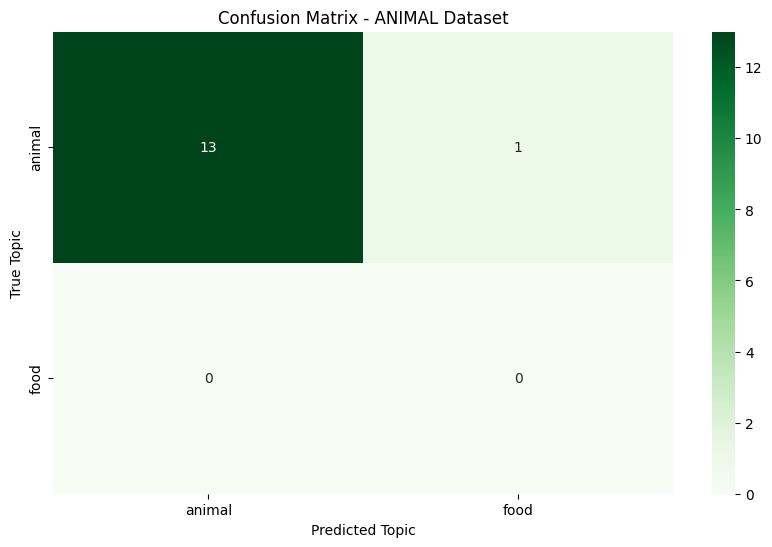

In [18]:
# === PHASE 5: ANIMAL DATASET ===
TEST_VIDEO_DIR = "/kaggle/input/testing-dataset/Animal"
OUTPUT_VIDEO_DIR = "/kaggle/working/converted_videos_animal"
os.makedirs(OUTPUT_VIDEO_DIR, exist_ok=True)

test_video_features = {}
test_captions = []
topics = []
sentiments = []
video_ids = []

test_video_files = [f for f in os.listdir(TEST_VIDEO_DIR) if f.endswith(('.mp4', '.avi'))]

# === Loop over Animal videos ===
for i, file_name in enumerate(test_video_files):
    input_path = os.path.join(TEST_VIDEO_DIR, file_name)
    video_id = os.path.splitext(file_name)[0]
    video_ids.append(video_id)

    # Convert if AVI
    if file_name.endswith('.avi'):
        output_path = os.path.join(OUTPUT_VIDEO_DIR, video_id + ".mp4")
        success = convert_to_mp4(input_path, output_path)
        if not success:
            print(f"[{i+1}] Skipped (conversion failed): {file_name}")
            continue
        video_path = output_path
    else:
        video_path = input_path

    # Play video
    print(f"\n[{i+1}/{len(test_video_files)}] Now Playing: {video_id}")
    display(play(video_path))

    # Extract frames
    frames = extract_frames(video_path)
    if len(frames) == 0:
        print(f"[{i+1}] Skipped (no frames): {video_id}")
        continue

    # Extract features
    features = cnn_model.predict(frames, verbose=0)
    mean_feature = np.mean(features, axis=0)
    test_video_features[video_id] = mean_feature

    # Generate caption
    caption = generate_caption(model, tokenizer, mean_feature, max_length=20)
    test_captions.append((video_id, caption))

    # Sentiment
    sentiment_result = sentiment_analyzer(caption)[0]
    sentiments.append(sentiment_result['label'])

    # Topic prediction
    topic_result = classifier(caption, labels)
    top_label = topic_result['labels'][0]
    topics.append(top_label)

    # Print individual results
    print(f"Caption: {caption}")
    print(f"Predicted Topic: {top_label}")
    print("-" * 60)

# === After all videos — Top 3 topics ===
topic_counts = Counter(topics)
print("\nTop 3 Topics in ANIMAL Dataset:")
for topic, count in topic_counts.most_common(3):
    print(f"{topic}: {count}")

# === Evaluation Metrics ===
y_true = ["animal"] * len(topics)
y_pred = topics

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted', zero_division=0)
recall = recall_score(y_true, y_pred, average='weighted', zero_division=0)
f1 = f1_score(y_true, y_pred, average='weighted', zero_division=0)

print("\nEvaluation Metrics (ANIMAL Dataset):")
print(f"Accuracy : {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall   : {recall:.2f}")
print(f"F1 Score : {f1:.2f}")

# === Confusion Matrix ===
labels_all = sorted(set(y_true + y_pred))
cm = confusion_matrix(y_true, y_pred, labels=labels_all)

plt.figure(figsize=(10, 6))
sns.heatmap(cm, annot=True, fmt="d", xticklabels=labels_all, yticklabels=labels_all, cmap="Greens")
plt.xlabel("Predicted Topic")
plt.ylabel("True Topic")
plt.title("Confusion Matrix - ANIMAL Dataset")
plt.show()


In [ ]:
# # Phase 5: Sentiment and Topic Classification on Generated Captions
# !pip install transformers torch --quiet

# from transformers import pipeline
# from collections import Counter
# sentiment_analyzer = pipeline('sentiment-analysis')
# classifier = pipeline("zero-shot-classification", model="microsoft/deberta-large-mnli")

# labels = [
#     "education", "health", "travel", "politics", "finance", "technology", "sports", "music",
#     "nature", "food", "animals", "vehicles", "shopping", "weather", "fitness", "art", "history",
#     "science", "family", "transportation", "war", "crime", "disaster", "fashion", "space",
#     "architecture", "religion", "military", "gaming", "internet", "meditation"
# ]

# # === Video Directory Setup ===
# TEST_VIDEO_DIR = "/kaggle/input/testing-dataset/Food"
# OUTPUT_VIDEO_DIR = "/kaggle/working/converted_videos"
# os.makedirs(OUTPUT_VIDEO_DIR, exist_ok=True)

# # === Process Videos ===
# test_video_features = {}
# test_captions = []
# topics = []
# sentiments = []

# test_video_files = [f for f in os.listdir(TEST_VIDEO_DIR) if f.endswith(('.mp4', '.avi'))]

# for i, file_name in enumerate(test_video_files):
#     input_path = os.path.join(TEST_VIDEO_DIR, file_name)
#     video_id = os.path.splitext(file_name)[0]

#     # Convert to mp4 if needed
#     if file_name.endswith('.avi'):
#         output_path = os.path.join(OUTPUT_VIDEO_DIR, video_id + ".mp4")
#         success = convert_to_mp4(input_path, output_path)
#         if not success:
#             print(f"[{i+1}] Skipped (conversion failed): {file_name}")
#             continue
#         video_path = output_path
#     else:
#         video_path = input_path

#     # Play the video
#     print(f"[{i+1}/{len(test_video_files)}] Now Playing: {video_id}")
#     display(play(video_path))

#     # Extract frames
#     frames = extract_frames(video_path)
#     if len(frames) == 0:
#         print(f"[{i+1}] Skipped (no frames): {video_id}")
#         continue

#     # Extract features and generate caption
#     features = cnn_model.predict(frames, verbose=0)
#     mean_feature = np.mean(features, axis=0)
#     test_video_features[video_id] = mean_feature

#     caption = generate_caption(model, tokenizer, mean_feature, max_length=20)
#     test_captions.append((video_id, caption))

#     # Sentiment (not printed)
#     sentiment_result = sentiment_analyzer(caption)[0]
#     sentiments.append(sentiment_result['label'])

#     # Topic
#     topic_result = classifier(caption, labels)
#     top_label = topic_result['labels'][0]
#     topics.append(top_label)

#     # Print result (without sentiment)
#     print(f"Caption: {caption}")
#     print(f"Topic: {top_label}")
#     print("-" * 60)

# # === Summary ===
# topic_counts = Counter(topics)
# print("Top 3 Topics:")
# for topic, count in topic_counts.most_common(3):
#     print(f"{topic}: {count}")

In [ ]:
# # === Setup ===
# !pip install transformers torch --quiet

# import os
# import numpy as np
# from collections import Counter
# from transformers import pipeline

# # === Sentiment and Topic Pipelines ===
# sentiment_analyzer = pipeline('sentiment-analysis')
# classifier = pipeline("zero-shot-classification", model="microsoft/deberta-large-mnli")

# labels = [
#     "education", "health", "travel", "politics", "finance", "technology", "sports", "music",
#     "nature", "food", "animals", "vehicles", "shopping", "weather", "fitness", "art", "history",
#     "science", "family", "transportation", "war", "crime", "disaster", "fashion", "space",
#     "architecture", "religion", "military", "gaming", "internet", "meditation", "entertainment"
# ]

# # === Directory Setup ===
# TEST_VIDEO_DIR = "/kaggle/input/test-video-social-media"
# OUTPUT_VIDEO_DIR = "/kaggle/working/converted_videos"
# os.makedirs(OUTPUT_VIDEO_DIR, exist_ok=True)

# # === Data Structures ===
# test_video_features = {}
# test_captions = []
# topics = []
# sentiments = []
# categories = []  # To track which folder/category the video came from

# # === Traverse and Process All Videos ===
# for category in os.listdir(TEST_VIDEO_DIR):
#     category_path = os.path.join(TEST_VIDEO_DIR, category)
#     if not os.path.isdir(category_path):
#         continue  # Skip non-folder items

#     video_files = [f for f in os.listdir(category_path) if f.endswith(('.mp4', '.avi'))]

#     for i, file_name in enumerate(video_files):
#         input_path = os.path.join(category_path, file_name)
#         video_id = os.path.splitext(file_name)[0]

#         # Convert to mp4 if needed
#         if file_name.endswith('.avi'):
#             output_path = os.path.join(OUTPUT_VIDEO_DIR, f"{category}_{video_id}.mp4")
#             success = convert_to_mp4(input_path, output_path)
#             if not success:


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

import seaborn as sns
import matplotlib.pyplot as plt

# 1. Get video IDs from predictions (same order as topics)
video_ids = list(test_video_features.keys())

# 2. True labels: all 'food'
y_true = ["food"] * len(video_ids)

# # 3. Predicted labels
y_pred = topics  # Make sure this list is the same length and order

# # 4. Classification report
# print("Classification Report:\n")
# print(classification_report(y_true, y_pred, zero_division=0))

# # 5. Accuracy
# accuracy = accuracy_score(y_true, y_pred)
# print(f"Accuracy: {accuracy:.2f}")

accuracy = accuracy_score(y_true, y_pred)

# Precision, Recall, F1 (average='weighted' handles class imbalance)
precision = precision_score(y_true, y_pred, average='weighted', zero_division=0)
recall = recall_score(y_true, y_pred, average='weighted', zero_division=0)
f1 = f1_score(y_true, y_pred, average='weighted', zero_division=0)

# Print results
print(f"Accuracy : {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall   : {recall:.2f}")
print(f"F1 Score : {f1:.2f}")
# 6. Confusion matrix
labels = sorted(list(set(y_true + y_pred)))  # All unique labels involved
cm = confusion_matrix(y_true, y_pred, labels=labels)

# 7. Plot confusion matrix
plt.figure(figsize=(10, 6))
sns.heatmap(cm, annot=True, fmt="d", xticklabels=labels, yticklabels=labels, cmap="Blues")
plt.xlabel("Predicted Topic")
plt.ylabel("True Topic")
plt.title("Confusion Matrix")
plt.show()


In [ ]:
# from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
# import seaborn as sns
# import matplotlib.pyplot as plt

# # All 30 labels to be shown in the confusion matrix
# all_labels = [
#     "education", "health", "travel", "politics", "finance", "technology", "sports", "music",
#     "nature", "food", "animals", "vehicles", "shopping", "weather", "fitness", "art", "history",
#     "science", "family", "transportation", "war", "crime", "disaster", "fashion", "space",
#     "architecture", "religion", "military", "gaming", "internet", "meditation"
# ]

# # 1. Get video IDs from predictions (same order as topics)
# video_ids = list(test_video_features.keys())

# # 2. True labels: all 'food'
# y_true = ["food"] * len(video_ids)

# # 3. Predicted labels (same order as video_ids)
# y_pred = topics  # Make sure this is the same length as y_true

# # 4. Classification report
# print("Classification Report:\n")
# print(classification_report(y_true, y_pred, labels=all_labels, zero_division=0))

# # 5. Accuracy
# accuracy = accuracy_score(y_true, y_pred)
# print(f"Accuracy: {accuracy:.2f}")

# # 6. Confusion matrix (include all 30 labels)
# cm = confusion_matrix(y_true, y_pred, labels=all_labels)

# # 7. Plot confusion matrix
# plt.figure(figsize=(14, 8))
# sns.heatmap(cm, annot=True, fmt="d", xticklabels=all_labels, yticklabels=all_labels, cmap="Blues")
# plt.xlabel("Predicted Topic")
# plt.ylabel("True Topic")
# plt.title("Confusion Matrix for Test Videos (True Label = Food)")
# plt.xticks(rotation=45, ha='right')
# plt.yticks(rotation=0)
# plt.tight_layout()
# plt.show()


In [ ]:
# input_folder = "/kaggle/input/test-video-social-media/Food"
# output_folder = "/kaggle/working/converted_videos"
# os.makedirs(output_folder, exist_ok=True)

# for file_name in os.listdir(input_folder):
#     if file_name.endswith('.avi'):
#         input_path = os.path.join(input_folder, file_name)
#         output_name = os.path.splitext(file_name)[0] + ".mp4"
#         output_path = os.path.join(output_folder, output_name)

#         # Convert the file
#         success = convert_to_mp4(input_path, output_path)
        
#         if success:
#             print(f"Converted and playing: {output_name}")
#             display(play(output_path))
#         else:
#             print(f"Failed to convert: {file_name}")

In [ ]:
# # Phase 5: Sentiment and Topic Classification on Generated Captions
# !pip install transformers torch --quiet

# from transformers import pipeline
# from collections import Counter

# sentiment_analyzer = pipeline('sentiment-analysis')
# classifier = pipeline("zero-shot-classification", model="microsoft/deberta-large-mnli")

# labels = [
#   "education", "health", "travel", "politics",
#   "finance", "technology", "sports", "music",
#   "nature", "food", "animals", "vehicles", "shopping", "weather",
#   "fitness", "art", "history", "science", "family",
#   "transportation", "war", "crime", "disaster", "fashion", 
#   "space", "architecture", "religion", "military", 
#   "gaming", "internet", "meditation"
# ]

# TEST_VIDEO_DIR = "/kaggle/input/test-video-social-media/Food"  # Replace with actual test dataset path
# test_video_features = {}

# test_video_files = [f for f in os.listdir(TEST_VIDEO_DIR) if f.endswith(".mp4")]
# for i, video_file in enumerate(test_video_files):  # Adjust the number as needed
#     video_id = os.path.splitext(video_file)[0]
#     video_path = os.path.join(TEST_VIDEO_DIR, video_file)
#     frames = extract_frames(video_path)
#     if len(frames) == 0:
#         continue
#     features = cnn_model.predict(frames, verbose=0)
#     test_video_features[video_id] = np.mean(features, axis=0)
#     print(f"[{i+1}/{len(test_video_files)}] Processed: {video_id}")

# # Analyze generated captions
# caption_outputs = []
# sentiments = []    
# test_captions = []

# for vid, feat in test_video_features.items():
#     caption = generate_caption(model, tokenizer, feat, max_length)
#     test_captions.append((vid, caption))

# topics = []
# sentiments = []

# for vid, cap in test_captions:
#     sentiment_result = sentiment_analyzer(cap)[0]
#     sentiments.append(sentiment_result['label'])

#     topic_result = classifier(cap, labels)
#     top_label = topic_result['labels'][0]
#     topics.append(top_label)
    
# for i, (vid, cap) in enumerate(test_captions):
#     print(f"Video: {vid}\nCaption: {cap}\nTopic: {topics[i]}\n")

# # Summary statistics
# from collections import Counter
# topic_counts = Counter(topics)
# print("Top 3 Topics:")
# for topic, count in topic_counts.most_common(3):
#     print(f"{topic}: {count}")
